# ARIMA vs LSTM for stock price analysis

In [2]:
# internal libraries
import os
import warnings
from math import sqrt


# external libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import plotly.offline
import plotly.express as px
import plotly.graph_objects as go
import plotly.subplots as sp 
import missingno as msno
from statsmodels.tsa.seasonal import seasonal_decompose, DecomposeResult
from statsmodels.stats.stattools import durbin_watson
from statsmodels.tsa.stattools import acf, pacf
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from statsmodels.tsa.arima.model import ARIMA
from statsmodels.tsa.stattools import adfuller
from sklearn.metrics import mean_squared_error
from sklearn.preprocessing import MinMaxScaler
from keras.models import Sequential
from keras.layers import Dense, LSTM
from keras.optimizers import Adam
from keras.callbacks import EarlyStopping
from keras.utils import plot_model

In [3]:
# Set project environment

FILE_PATH = os.getcwd() + "/data/AMZN.csv"

plotly.offline.init_notebook_mode()
warnings.filterwarnings("ignore")

In [4]:
# Load data and set date as index
def load_data():
    df = pd.read_csv(FILE_PATH, sep=',',decimal='.', index_col='Date', parse_dates=True)

    # lowercase column names
    df.columns = [col.lower() for col in df.columns]

    return df

df = load_data()

df.tail()

,open,high,low,close,adj close,volume
Date,,,,,,
2024-02-08,169.649994,171.429993,168.880005,169.839996,169.839996,42316500
2024-02-09,170.899994,175.000000,170.580002,174.449997,174.449997,56986000
2024-02-12,174.800003,175.389999,171.539993,172.339996,172.339996,51050400
2024-02-13,167.729996,170.949997,165.750000,168.639999,168.639999,56345100
2024-02-14,169.210007,171.210007,168.279999,170.979996,170.979996,42760600


The data used in this notebook was obtained from [Yahoo Finance](https://de.finance.yahoo.com/quote/AMZN/history?period1=863654400&period2=1707955200&interval=1d&filter=history&frequency=1d&includeAdjustedClose=true). Is contains the daily opening, closing, high and low prices and the trading volume of the Amazon stock from  15 May 1997 to 22 January 2024. Amazon is a company that has been listed on the stock exchange since 1997 and has experienced a significant increase in its stock price over the years. Amazon started as a small online bookstore and has grown into one of the largest online retailers in the world. The company has also expanded into other areas such as cloud computing, artificial intelligence and digital streaming. The stock price of Amazon has been very volatile over the years and has experienced significant fluctuations. In this notebook, we will use ARIMA and LSTM to predict the stock price of Amazon. We will compare the performance of the two models and determine which one is better for predicting the stock price of Amazon.

## Business Understanding

The data contains 6732 rows and the following columns:
- Date: The date of the trading day
- Open: The opening price 
- High: The highest price
- Low: The lowest price
- Close: The closing price
- Adj Close: The adjusted closing price
- Volume: The trading volume

## Data Understanding

The Data Understanding aims to provide a general understanding of the data and to identify the data quality issues that need to be addressed before the data can be used for analysis. 
It also paves the way for the data preparation and modelling. Since the goal of this notebook is to compare the performance of ARIMA and LSTM models, the understanding of the provided time series data is a crucial step to determine the best model for the analysis. It also helps with the evaluation of the model's performance and the interpretation of the results by providing insights into the data's characteristics and patterns.

In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 6732 entries, 1997-05-15 to 2024-02-14
Data columns (total 6 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   open       6732 non-null   float64
 1   high       6732 non-null   float64
 2   low        6732 non-null   float64
 3   close      6732 non-null   float64
 4   adj close  6732 non-null   float64
 5   volume     6732 non-null   int64  
dtypes: float64(5), int64(1)
memory usage: 368.2 KB


In [46]:

def plot_stock_price(df: pd.DataFrame):

    fig = go.Figure( 
        data=[
            go.Candlestick(
                x=df.index,
                open=df["open"],
                high=df["high"],
                low=df["low"],
                close=df["close"],
            )
        ]
    )

    fig.update_layout(
        title="Amazon Stock Price",
        yaxis_title="Price",
        xaxis_title="Date",
        font=dict(family="Courier New, monospace", size=18, color="#333"),
    )

    fig.show()

plot_stock_price(df.copy())

### Daily Returns

In [7]:
# plot the daily returns

def plot_daily_returns(df: pd.DataFrame):
    df['daily_returns'] = df['adj close'].pct_change(fill_method=None) # type: ignore

    fig = px.line(df, x=df.index, y="daily_returns", title='Daily Returns of Amazon Stock Price', labels={'daily_returns': 'Daily Returns', 'index': 'Date'})
    fig.show()

plot_daily_returns(df.copy())

The daily returns are calculated as the percentage change in the index value from one day to the next. The daily returns are calculated as follows:

$$
r_t = \frac{P_t - P_{t-1}}{P_{t-1}} \times 100
$$

where $P_t$ is the index value at time $t$ and $P_{t-1}$ is the index value at time $t-1$. The daily returns are calculated for the period from 30 December 1987 to 22 January 2024. The daily returns are plotted in the figure above.

In [45]:
# plot the daily returns as a histogram and calculate the mean and standard deviation of the daily returns 

def plot_daily_returns_histogram(df: pd.DataFrame):
    df['daily_returns'] = df['adj close'].pct_change(fill_method=None) # type: ignore

    fig = px.histogram(df, x="daily_returns", title='Daily Returns of Amazon Stock Price', labels={'daily_returns': 'Daily Returns', 'index': 'Date'})

    mean = df['daily_returns'].mean()
    std = df['daily_returns'].std()

    fig.update_layout(
        title="Amazon Stock Price Daily Returns Histogram",
        yaxis_title="Count",
        xaxis_title="Daily Returns",
        font=dict(family="Courier New, monospace", size=18, color="#333"),
        legend_title_text=f"Mean: {str(np.round(mean, 4))} Std: {str(np.round(std, 4))}"
    )

    fig.add_trace(go.Scatter(x=[mean, mean], y=[0, 800], mode="lines", name="Mean"))
    fig.add_trace(go.Scatter(x=[mean + std, mean + std], y=[0, 800], mode="lines", name="Std"))
    fig.add_trace(go.Scatter(x=[mean - std, mean - std], y=[0, 800], mode="lines", name="Std"))
    fig.add_trace(go.Scatter(x=[mean + 2 * std, mean + 2 * std], y=[0, 800], mode="lines", name="2*Std"))
    fig.add_trace(go.Scatter(x=[mean - 2 * std, mean - 2 * std], y=[0, 800], mode="lines", name="2*Std"))

    fig.show()

plot_daily_returns_histogram(df.copy())

The histogram of the daily returns is shown in the figure above. The histogram shows that the daily returns are normally distributed. The mean of the daily returns is 0.0017 and the standard deviation is 0.0357. The mean and standard deviation of the daily returns are used to calculate the mean and standard deviation of the daily returns. The mean and standard deviation of the daily returns as calculated as follows:

$$
\mu = \frac{1}{T} \sum_{t=1}^T r_t
$$

$$
\sigma = \sqrt{\frac{1}{T} \sum_{t=1}^T (r_t - \mu)^2}
$$

where $r_t$ is the daily return at time $t$ and $T$ is the number of days and $\mu$ and $\sigma$ are the mean and standard deviation of the daily returns.

In [9]:
# plot the daily returns as a density plot

def plot_daily_returns_density(df: pd.DataFrame):
    df['daily_returns'] = df['close'].pct_change(fill_method=None) # type: ignore

    fig = px.density_contour(df, x="daily_returns", title='Daily Returns of Amazon Stock Price', labels={'daily_returns': 'Daily Returns', 'index': 'Date'}, histnorm='probability density')

    fig.update_layout(
        title="Distribution of Daily Returns of Amazon Stock Price",
        yaxis_title="Year",
        xaxis_title="Daily Returns",
        font=dict(family="Courier New, monospace", size=18, color="#333"),
    )

    fig.show()

plot_daily_returns_density(df.copy())

The density plot above shows the distribution of daily returns. A density contour plot is a 2D representation of the relationship between two continuous variables. 

### Volatility and Moving Average

In [10]:
# plot volatility and moving average

def plot_volatility_moving_average(df: pd.DataFrame):
    df['daily_returns'] = df['close'].pct_change(fill_method=None) # type: ignore
    df['volatility'] = df['daily_returns'].rolling(window=21).std()
    df['moving_average'] = df['close'].rolling(window=21).mean()

    # use log scale for better visualization
    df['volatility'] = np.log(df['volatility'])
    df['moving_average'] = np.log(df['moving_average'])

    fig = go.Figure()

    fig.add_trace(go.Scatter(x=df.index, y=df['volatility'], mode='lines', name='Volatility'))
    fig.add_trace(go.Scatter(x=df.index, y=df['moving_average'], mode='lines', name='Moving Average'))

    fig.update_layout(
        title="Amazon Stock Price Volatility and Moving Average",
        yaxis_title="Value",
        xaxis_title="Date",
        font=dict(family="Courier New, monospace", size=18, color="#333"),
    )

    fig.show()

plot_volatility_moving_average(df.copy())

By plotting the volatility and moving average of the daily returns, we can see that the volatility of the daily returns has increased over the years. The volatility of the daily returns is calculated as the standard deviation of the daily returns over a rolling window of 21 days. The moving average of the daily returns is calculated as the mean of the daily returns over a rolling window of 21 days. The volatility and moving average of the daily returns are plotted in the figure above. The volatility is calculated as follows:

$$
\sigma_t = \sqrt{\frac{1}{N} \sum_{i=1}^N (r_{t-i} - \mu)^2}
$$

where $r_{t-i}$ is the daily return at time $t-i$ and $\mu$ is the mean of the daily returns over the rolling window of 21 days and $N$ is the number of days in the rolling window.

The moving average is calculated as follows:

$$
\mu_t = \frac{1}{N} \sum_{i=1}^N r_{t-i}
$$

where $r_{t-i}$ is the daily return at time $t-i$ and $N$ is the number of days in the rolling window.

### Volatility and Trading Volume

In [43]:
# plot the relationship between the volatility and the trading volume and calculate the correlation

def plot_volatility_trading_volume(df: pd.DataFrame):
    # set missing values to NaN
    df['volume'] = df['volume'].replace(0, np.nan)
    df['daily_returns'] = df['close'].pct_change(fill_method=None) # type: ignore
    df['volatility'] = df['daily_returns'].rolling(window=21).std()
    df['volume'] = df['volume'].rolling(window=21).mean()

    fig = px.scatter(df, x="volatility", y="volume", title='Volatility and Trading Volume', symbol=df.index.year) # type: ignore
    correlation = df['volatility'].corr(df['volume'])


    fig.update_layout(
        title="Amazon Stock Price Volatility and Trading Volume",
        yaxis_title="Volume",
        xaxis_title="Volatility",
        font=dict(family="Courier New, monospace", size=18, color="#333"),
        legend_title_text=f"Correlation: {str(np.round(correlation, 4))}"
    )

    fig.show()

plot_volatility_trading_volume(df.copy())

In this scatter plot we can see the relationship between the daily returns and the trading volume. The scatter plot shows that the daily returns are slightly positively correlated with the trading volume. The correlation coefficient of Pearson is 0.4154. This means that the higher the volatility of the market, the higher the trading volume. We can also observe, that the highest trading volume is observed in the years of 2008 and 2020. These years are known for the financial crisis and the COVID-19 pandemic. So we can conclude that the trading volume is higher in times of crisis and uncertainty in the market. 

### Autocorrelation

In [42]:
# plot the autocorrelation of the daily returns

def plot_autocorrelation(df: pd.DataFrame):
    df['daily_returns'] = df['close'].pct_change(fill_method=None) # type: ignore

    fig = px.scatter(df, x="daily_returns", y="daily_returns", title='Autocorrelation of Daily Returns', symbol=df.index.year) # type: ignore

    fig.update_layout(
        title="Amazon Stock Price Autocorrelation of Daily Returns",
        yaxis_title="Daily Returns",
        xaxis_title="Daily Returns",
        font=dict(family="Courier New, monospace", size=18, color="#333"),
    )

    fig.show()

plot_autocorrelation(df.copy())

The linear distribution of the daily returns is shown in the figure above. A linear distribution indicates that the daily returns are not correlated with each other.

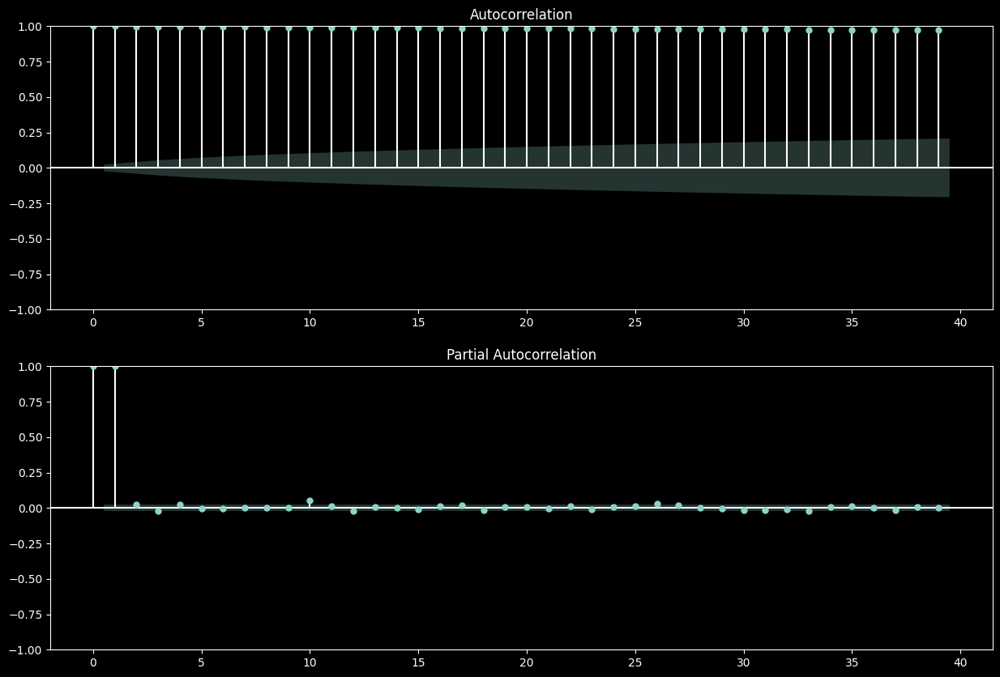

In [13]:
# autocorrelation function and partial autocorrelation function

def plot_autocorrelation_function(df: pd.DataFrame):
    df['daily_returns'] = df['adj close'].pct_change()

    fig, ax = plt.subplots(2, 1, figsize=(15, 10))

    plot_acf(df['open'].dropna(), ax=ax[0])
    plot_pacf(df['open'].dropna(), ax=ax[1])

    plt.show()

plot_autocorrelation_function(df.copy())

The autocorrelation plot above shows the autocorrelation of the daily returns. The autocorrelation plot is a plot of the autocorrelation of a time series as a function of the lag. The autocorrelation of the daily returns is calculated as follows:

$$
\rho_k = \frac{\sum_{t=k+1}^T (r_t - \mu)(r_{t-k} - \mu)}{\sum_{t=1}^T (r_t - \mu)^2}
$$

where $r_t$ is the daily return at time $t$, $\mu$ is the mean of the daily returns, $T$ is the number of days and $k$ is the lag.

The partial autocorrelation plot above shows the partial autocorrelation of the daily returns. The partial autocorrelation plot is a plot of the partial autocorrelation of a time series as a function of the lag. The partial autocorrelation of the daily returns is calculated as follows:

$$
\phi_{kk} = \frac{\sum_{t=k+1}^T (r_t - \mu)(r_{t-k} - \mu)}{\sum_{t=1}^T (r_t - \mu)^2}
$$

where $r_t$ is the daily return at time $t$, $\mu$ is the mean of the daily returns, $T$ is the number of days and $k$ is the lag.

We can see that the autocorrelation of the daily returns is close to zero for all lags. This means that the daily returns are not correlated with each other.

### Seasonal Decomposition

In [14]:
# plot the seasonal decomposition

def plot_seasonal_decompose(
    result: DecomposeResult,
    dates: pd.Series = None, # type: ignore
    title: str = "Seasonal Decomposition",
):
    x_values = dates if dates is not None else np.arange(len(result.observed))
    return (
        sp.make_subplots(
            rows=4,
            cols=1,
            subplot_titles=["Observed", "Trend", "Seasonal", "Residuals"],
        )
        .add_trace(
            go.Scatter(x=x_values, y=result.observed, mode="lines", name="Observed"),
            row=1,
            col=1,
        )
        .add_trace(
            go.Scatter(x=x_values, y=result.trend, mode="lines", name="Trend"),
            row=2,
            col=1,
        )
        .add_trace(
            go.Scatter(x=x_values, y=result.seasonal, mode="lines", name="Seasonal"),
            row=3,
            col=1,
        )
        .add_trace(
            go.Scatter(x=x_values, y=result.resid, mode="lines", name="Residual"),
            row=4,
            col=1,
        )
        .update_layout(
            height=900,
            title=f"<b>{title}</b>",
            margin={"t": 100},
            title_x=0.5,
            showlegend=False,
        )
    )

# calculate the average number of trading days per year
trading_days_per_year = df.index.year.value_counts().mean() # type: ignore
print(f"Average number of trading days per year: {trading_days_per_year}")


decomposition = seasonal_decompose(df["adj close"], model='additive', period=int(np.round(trading_days_per_year, 0)), two_sided=False, extrapolate_trend=240)
fig = plot_seasonal_decompose(decomposition, dates=pd.Series(df.index) ,title="Seasonal Decomposition of Amazon Stock Price")
fig.show()

Average number of trading days per year: 240.42857142857142


The plot of the seasonal decomposition of the closing price shows the trend, seasonality and noise of the closing price. The seasonal decomposition of the closing price is calculated using the additive model. The additive model is given by:

$$
r_t = T_t + S_t + N_t
$$

where $r_t$ is the daily return at time $t$, $T_t$ is the trend at time $t$, $S_t$ is the seasonality at time $t$ and $N_t$ is the noise at time $t$. 

The trend of closing price is calculated as the following:

$$
T_t = \frac{1}{m} \sum_{j=1}^m r_{t-j}
$$

where $r_t$ is the daily return at time $t$ and $m$ is the number of days in a month. The seasonality of closing price is calculated as the following:

$$
S_t = \frac{1}{n} \sum_{j=1}^n r_{t-j}
$$

where $r_t$ is the daily return at time $t$ and $n$ is the number of days in a year. Positive values of the seasonality indicate that the closing price is higher than the trend and negative values of the seasonality indicate that the closing price is lower than the trend.
The noise of closing price is calculated as the following:

$$
N_t = r_t - T_t - S_t
$$

The plot of the seasonal decomposition of the closing price shows that the closing price has positive trend and follows a seasonal pattern. The seasonal pattern is almost the same every year. The noise of the closing price is the difference between the closing price and the trend and seasonality. The noise of the closing price is the random component of the closing price that cannot be explained by the trend and seasonality. A positive value of the noise indicates that the closing price is higher than the trend and seasonality and a negative value of the noise indicates that the closing price is lower than the trend and seasonality.

### Heavy Tails and Kurtosis

In [41]:
# determine and visualize the heavy tails and kurtosis of the daily returns

def plot_heavy_tails_kurtosis(df: pd.DataFrame):
    df['daily_returns'] = df['adj close'].pct_change(fill_method=None) # type: ignore

    fig = px.histogram(df, x="daily_returns", title='Daily Returns of Amazon Stock Price', labels={'daily_returns': 'Daily Returns', 'index': 'Date'}, histnorm='probability density')

    kurtosis = df['daily_returns'].kurtosis()

    # data is heavy tailed if kurtosis > 3 
    fig.add_trace(go.Scatter(x=[0, 0], y=[0, 20], mode="lines", name="Kurtosis"))

    fig.update_layout(
        title="Amazon Stock Price Daily Returns",
        yaxis_title="Count",
        xaxis_title="Daily Returns",
        font=dict(family="Courier New, monospace", size=18, color="#333"),
        legend_title_text=f"Kurtosis: {str(np.round(float(kurtosis), 4))}" # type: ignore
    )

    fig.show()

plot_heavy_tails_kurtosis(df.copy())

A high kurtosis means that the tails of the distribution are heavy and that the distribution has more outliers than a normal distribution. The kurtosis of the daily returns is 11.0179. This means that the daily returns have heavy tails and that the distribution has more outliers than a normal distribution. The kurtosis of the daily returns is calculated as follows:

$$
\kappa = \frac{1}{T} \sum_{t=1}^T \left( \frac{r_t - \mu}{\sigma} \right)^4
$$

where $r_t$ is the daily return at time $t$, $\mu$ is the mean of the daily returns, $\sigma$ is the standard deviation of the daily returns and $T$ is the number of days.

### Volatility Clustering

In [16]:
# investigate volatility

def plot_volatility(df: pd.DataFrame):
    df['daily_returns'] = df['adj close'].pct_change(fill_method=None) # type: ignore
    df['volatility'] = df['daily_returns'].rolling(window=21).std()

    fig = px.line(df, x=df.index, y="volatility", title='Volatility Clustering of Amazon Stock Price', labels={'volatility': 'Volatility', 'index': 'Date'})

    fig.update_layout(
        title="Amazon Stock Price Volatility",
        yaxis_title="Volatility",
        xaxis_title="Date",
        font=dict(family="Courier New, monospace", size=18, color="#333"),
    )

    fig.show()

plot_volatility(df.copy())

In [17]:
# plot seasonal decomposition of the volatility

def plot_volatility_seasonal_decompose(df: pd.DataFrame):
    df['daily_returns'] = df['adj close'].pct_change()
    df['volatility'] = df['daily_returns'].rolling(window=21).std()

    trading_days_per_year = df.index.year.value_counts().mean() # type: ignore

    decomposition = seasonal_decompose(df["volatility"].dropna(), model='additive', period=int(np.round(trading_days_per_year, 0)), two_sided=False, extrapolate_trend=240)
    fig = plot_seasonal_decompose(decomposition, dates=pd.Series(df.index) ,title="Seasonal Decomposition of Amazon Stock Price Volatility")
    fig.show()

plot_volatility_seasonal_decompose(df.copy())

In [18]:
# volatility and daily returns

def plot_volatility_daily_returns(df: pd.DataFrame):
    df['daily_returns'] = df['adj close'].pct_change(fill_method=None) # type: ignore
    df['volatility'] = df['daily_returns'].rolling(window=21).std()

    fig = px.scatter(df, x="daily_returns", y="volatility", title='Volatility and Daily Returns', symbol=df.index.year) # type: ignore

    fig.update_layout(
        title="Amazon Stock Price Volatility and Daily Returns",
        yaxis_title="Volatility",
        xaxis_title="Daily Returns",
        font=dict(family="Courier New, monospace", size=18, color="#333"),
    )

    fig.show()

plot_volatility_daily_returns(df.copy())

Volatility clustering is the phenomenon of large changes in the stock market being followed by large changes and small changes being followed by small changes. The plot of the volatility clustering of the daily returns shows that the volatility of the daily returns is clustered. This means that large changes in the stock market are followed by large changes and small changes are followed by small changes. The volatility clustering of the daily returns is calculated as the standard deviation of the daily returns over a rolling window of 21 days.

### Fractional Integration and Long Memory

In [47]:
# investigate whether the autocorrelation of the daily returns of the DAX decay more slowly than in a random series

def compare_autocorrelation(df: pd.DataFrame):

    autocorr_dax = df['adj close'].pct_change(fill_method=None).autocorr() # type: ignore

    # Generate random series with the same length as daily returns
    random_series = np.random.randn(len(df))

    # Calculate autocorrelation of random series
    autocorr_random = pd.Series(random_series).autocorr()

    # Plot autocorrelation
    fig = go.Figure()

    fig.add_trace(
        go.Scatter(x=df.index, y=random_series, mode="lines", name="Random Series")
    )
    fig.add_trace(go.Scatter(x=df.index, y=df['close'].pct_change(fill_method=None), mode='lines', name='Amazon')) # type: ignore

    fig.update_layout(
        title="Autocorrelation of Daily Returns",
        yaxis_title="Value",
        xaxis_title="Date",
        font=dict(family="Courier New, monospace", size=18, color="#333"),
    )

    fig.show()

    # Compare autocorrelation values
    if autocorr_dax > autocorr_random:
        print("The autocorrelation of the daily returns decays more slowly than in a random series.")
    else:
        print("The autocorrelation of the daily returns does not decay more slowly than in a random series.")

compare_autocorrelation(df.copy())

The autocorrelation of the daily returns does not decay more slowly than in a random series.


In [49]:
# investigate long memory 

def hurst_exponent(time_series):
    """Returns the Hurst Exponent of the time series"""
    lags = range(2, 100)
    tau = [np.sqrt(np.std(np.subtract(time_series[lag:], time_series[:-lag]))) for lag in lags]
    poly = np.polyfit(np.log(lags), np.log(tau), 1)
    return poly[0]*2.0


# Calculate the Hurst Exponent for the stock
hurst = hurst_exponent(df["adj close"].values)
print(f"Hurst Exponent: {hurst}")

Hurst Exponent: 0.4633310633830021


The Hurst exponent is a measure of the long memory of a time series. The Hurst exponent is calculated as the following:

$$
H = \frac{1}{2} \left( \frac{\log(R/S)}{\log(n)} \right)
$$

where $R/S$ is the rescaled range of the time series and $n$ is the number of days. The $R/S$ is calculated as the following:

$$
R/S = \frac{\max_{1 \leq k \leq n} \left( \sum_{t=1}^k (r_t - \mu) \right)}{\frac{1}{n} \sum_{t=1}^n (r_t - \mu)}
$$

where $r_t$ is the value at time $t$, $\mu$ is the mean and $n$ is the number of days. 

Since the Hurst exponent is close to 0.5, the stock price has long memory and are persistent. This means that the stock price is not mean reverting and that the stock price is persistent.

In [20]:
# Durbin-Watson test

def durbin_watson_test(df: pd.DataFrame):
    dw = durbin_watson(df['adj close'].pct_change(fill_method=None).dropna()) # type: ignore
    print(f"Durbin-Watson test statistic: {dw}")

# Call the function with your dataframe
durbin_watson_test(df.copy())

Durbin-Watson test statistic: 1.986993803449915


The Durbin-Watson test is used to test for autocorrelation in the daily returns. The Durbin-Watson test statistic is calculated as follows:

$$
DW = \frac{\sum_{t=2}^T (r_t - r_{t-1})^2}{\sum_{t=1}^T r_t^2}
$$

where $r_t$ is the daily return at time $t$ and $T$ is the number of days. The Durbin-Watson test statistic is used to test for autocorrelation in the daily returns. The Durbin-Watson test statistic is 1.987. The result of the Durbin-Watson test is a number between 0 and 4. A number close to 2 indicates that there is no autocorrelation in the daily returns. A number close to 0 indicates positive autocorrelation and a number close to 4 indicates negative autocorrelation. Since the Durbin-Watson test statistic is close to 2, we can conclude that there is no autocorrelation in the daily returns.

### Leverage Effect

In [39]:
# investigate the leverage effect and the correlation between returns and volatility

def plot_leverage_effect_and_volatility_correlation(df: pd.DataFrame):

    # Calculate daily returns
    df['returns'] = df['close'].pct_change()

    # Calculate a rolling measure of volatility (using a 21-day moving window, typical of trading days in a month)
    df['volatility'] = df['returns'].rolling(window=21).std()

    # Calculate the correlation between returns and volatility
    correlation = df["returns"].corr(df["volatility"])

    # Calculate the leverage effect
    df['leverage_effect'] = df['returns'] * df['volatility'].shift(1)

    # Plot the leverage effect and the correlation between returns and volatility
    fig = go.Figure()

    fig.add_trace(go.Scatter(x=df.index, y=df['leverage_effect'], mode='lines', name='Leverage Effect'))
    fig.add_trace(go.Scatter(x=df.index, y=df['volatility'], mode='lines', name='Volatility'))

    fig.update_layout(
        title="Leverage Effect and Volatility Correlation",
        yaxis_title="Value",
        xaxis_title="Date",
        font=dict(family="Courier New, monospace", size=18, color="#333"),
        legend_title_text=f"Correlation: {str(np.round(correlation, 4))}"
    )

    fig.show()

plot_leverage_effect_and_volatility_correlation(df.copy())

The leverage effect is the negative correlation between the returns and the volatility of the returns. The leverage effect is calculated as the correlation between the daily returns and the volatility of the daily returns. The leverage effect is 0.041. This means that the daily returns are slightly positively correlated with the volatility of the daily returns. The leverage effect is calculated as follows:

$$
\text{leverage effect} = \frac{\sum_{t=1}^T (r_t - \mu)(\sigma_t - \sigma)}{\sum_{t=1}^T (r_t - \mu)^2}
$$

where $r_t$ is the daily return at time $t$, $\mu$ is the mean of the daily returns, $\sigma_t$ is the volatility of the daily returns at time $t$ and $\sigma$ is the mean of the volatility of the daily returns.

### Missing Values

In [22]:
# visualize missing values per weekday
def visualize_missing_values_per_weekday(df: pd.DataFrame):
    df['weekday'] = df.index.weekday # type: ignore

    missing_values_per_weekday = df.pivot_table(index='weekday', aggfunc=lambda x: x.isnull().sum()).sum(axis=1)

    fig = px.bar(x=missing_values_per_weekday.index, y=missing_values_per_weekday.values, title='Missing Values per Weekday')
    fig.update_layout(
        title="Missing Values per Weekday",
        yaxis_title="Count",
        xaxis_title="Weekday",
        font=dict(family="Courier New, monospace", size=18, color="#7f7f7f"),
    )
    # mask the x-axis label with weekday names
    fig.update_xaxes(
        tickmode="array",
        tickvals=[0, 1, 2, 3, 4],
        ticktext=[
            "Mon",
            "Tue",
            "Wed",
            "Thu",
            "Fri",
        ],
    )

    fig.show()


visualize_missing_values_per_weekday(df.copy())

In [23]:
# visualize missing values during the years 2014-2024

def visualize_missing_values_per_year(df: pd.DataFrame):
    missing_values_per_year = df.resample('YE').apply(lambda x: x.isnull().sum().sum()).sum(axis=1) # type: ignore

    fig = px.bar(x=missing_values_per_year.index, y=missing_values_per_year.values, title='Missing Values per Year') # type: ignore

    fig.update_layout(
        title="Missing Values per Year",
        yaxis_title="Count",
        xaxis_title="Year",
        font=dict(family="Courier New, monospace", size=18, color="#7f7f7f"),
    )
    fig.show()

visualize_missing_values_per_year(df.copy())

The data contains no missing values. The data is complete and can be used for analysis.

## Data Preparation

Now that we have a good understanding of the data, we can start with the data preparation to make the data ready for modelling.

In [24]:
# Augmented Dickey-Fuller test

def get_stationarity(df: pd.DataFrame):

    # rolling statistics
    rolling_mean = df["adj close"].rolling(window=21).mean()
    rolling_std = df["adj close"].rolling(window=21).std()

    # rolling statistics plot
    fig = go.Figure()
    fig.add_trace(go.Scatter(x=df.index, y=df["adj close"], mode="lines", name="Original"))
    fig.add_trace(go.Scatter(x=df.index, y=rolling_mean, mode="lines", name="Rolling Mean"))
    fig.add_trace(go.Scatter(x=df.index, y=rolling_std, mode="lines", name="Rolling Std"))

    fig.update_layout(title="Rolling Mean & Standard Deviation", xaxis_title="Date", yaxis_title="Price")
    fig.show()

    # Dickey–Fuller test:
    result = adfuller(df["adj close"])
    print(f"ADF Statistic: {result[0]}")
    print(f"p-value: {result[1]}")
    print("Critical Values:")
    for key, value in result[4].items(): # type: ignore
        print("\t{}: {}".format(key, value))

In [25]:
# original data

get_stationarity(df.copy())

ADF Statistic: 0.8855301351858951
p-value: 0.9928985551526608
Critical Values:
	1%: -3.4313268266785926
	5%: -2.8619716758423386
	10%: -2.5669997774289297


In [26]:
# log data

get_stationarity(np.log(df.copy())) # type: ignore

ADF Statistic: -1.8812090334476543
p-value: 0.34095194783661675
Critical Values:
	1%: -3.4313268266785926
	5%: -2.8619716758423386
	10%: -2.5669997774289297


In [27]:
df_log = pd.DataFrame(np.log(df))
rolling_mean = df_log.rolling(window=21).mean()
df_log_minus_mean = df_log - rolling_mean
df_log_minus_mean.dropna(inplace=True)

get_stationarity(df_log_minus_mean)

ADF Statistic: -11.762490918590906
p-value: 1.1392262418639577e-21
Critical Values:
	1%: -3.4313297537494396
	5%: -2.8619729691501026
	10%: -2.5670004658825696


In [28]:
df_log_shift = df_log - df_log.shift()
df_log_shift.dropna(inplace=True)


get_stationarity(df_log_shift)

ADF Statistic: -13.980804374217193
p-value: 4.1809643708121255e-26
Critical Values:
	1%: -3.4313268266785926
	5%: -2.8619716758423386
	10%: -2.5669997774289297


The ADF test is used to test for stationarity in the data. The ADF test statistic is calculated as follows:



where $r_t$ is the daily return (or any value) at time $t$, $\mu$ is the mean of the daily returns and $T$ is the number of days. The ADF test statistic is used to test for stationarity in the daily returns. A time series is stationary if the mean and variance of the time series do not change over time. A time series is considered stationary if the p-value is less than 0.05, which means that the null hypothesis of non-stationarity is rejected. The critical values for the different intervals should also be as close to the ADF Statistic as possible. The p-value of the ADF test is 0.34 which means that the null hypothesis of non-stationarity is rejected. This means that the adj close prices are not stationary.

### Autocorrelation and Partial Autocorrelation

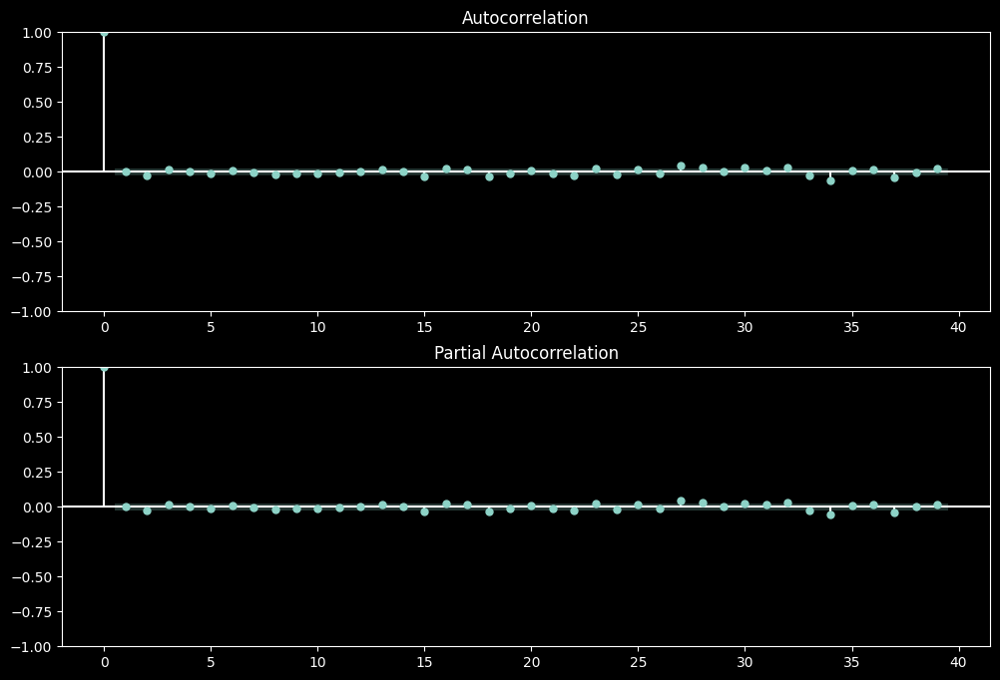

In [29]:
# ACF and PACF plots

def plot_acf_pacf(df: pd.DataFrame):    
    fig, ax = plt.subplots(2, 1, figsize=(12, 8))
    plot_acf(df['adj close'].pct_change().dropna(), ax=ax[0])
    plot_pacf(df['adj close'].pct_change().dropna(), ax=ax[1])
    plt.show()

plot_acf_pacf(df.copy())

## Modelling

In [30]:
# train test split

def train_test_split(df: pd.DataFrame):
    # Split the data into a training and test set
    train_size = int(len(df) * 0.8)
    train, test = df.iloc[:train_size], df.iloc[train_size:]

    # Create a plot
    fig = go.Figure()

    # Original data
    fig.add_trace(go.Scatter(x=train.index, y=train['adj close'], mode='lines', name='Train'))
    fig.add_trace(go.Scatter(x=test.index, y=test['adj close'], mode='lines', name='Test'))

    fig.update_layout(title='Train Test Split', xaxis_title='Date', yaxis_title='Adj Close Price')
    fig.show()

    return train, test

train, test = train_test_split(df)

### ARIMA

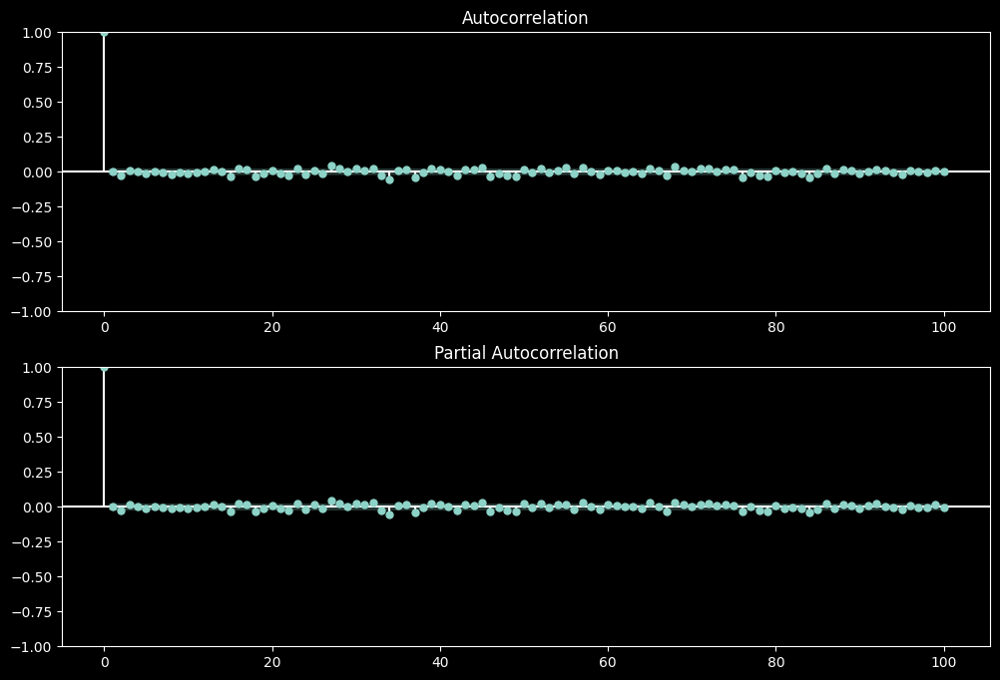

In [31]:
# plot PACF and ACF

def plot_acf_pacf(df: pd.DataFrame):
    
    fig, ax = plt.subplots(2, 1, figsize=(12, 8))
    plot_acf(df['adj close'], ax=ax[0], lags=100)
    plot_pacf(df['adj close'], ax=ax[1], lags=100)
    plt.show()	
   

plot_acf_pacf(df_log_shift)

The Partial Autocorrelation Function (PACF) plot is used to determine the order of the AR term in the ARIMA model. The PACF plot shows that the PACF of the adj close is not significant over all lags. This means that the order of the AR term in the ARIMA model is 0.
The Autocorrelation Function (ACF) plot is used to determine the order of the MA term in the ARIMA model. The ACF plot shows that the ACF of the adj close is also not significant over all lags. This means that the order of the MA term in the ARIMA model is 0.

In [32]:
#  ARIMA model

def arima_model(series, data_split, params, log):

    # log shift the series if log is True
    if log == True:
        series_dates = series.index
        series_log = np.log(series)
        series = series_log - series_log.shift().dropna()

    # create training and testing data sets based on user split fraction
    size = int(len(series) * data_split)
    train, test = series[0:size], series[size : len(series)]
    history = [val for val in train]
    predictions = []

    # creates a rolling forecast by testing one value from the test set, and then add that test value
    # to the model training, followed by testing the next test value in the series
    for t in range(len(test)):
        model = ARIMA(history, order=(params[0], params[1], params[2]))
        model_fit = model.fit()
        output = model_fit.forecast()
        predictions.append(output[0])
        obs = test[t]
        history.append(obs)

    test_dates = test.index

    # inverse log shift transformation
    if log == True:
        # series
        series = series + series_log.shift()
        series = pd.Series(np.exp(series), index=series_dates)
        series.dropna(inplace=True)

        # predictions
        predictions = predictions + series_log[size: len(series_log)].shift()
        predictions = pd.Series(np.exp(predictions), index=test_dates)
        predictions.dropna(inplace=True)

        # test
        test = test + series_log[size: len(series_log)].shift()
        test = pd.Series(np.exp(test), index=test_dates)
        test.dropna(inplace=True)

        # train
        train = train + series_log[0:size].shift()
        train = pd.Series(np.exp(train), index=series_dates)
        train.dropna(inplace=True)

    else:
        # creates pandas series with datetime index for the predictions
        predictions = pd.Series(predictions, index=test_dates)

    # generates plots to compare the predictions for out-of-sample data to the actual test values
    fig = go.Figure()
    fig.add_trace(go.Scatter(x=series.index, y=series.values, mode="lines", name="Original Data"))
    fig.add_trace(go.Scatter(x=test_dates, y=test, mode="lines", name="Test Data"))
    fig.add_trace(go.Scatter(x=test_dates, y=predictions, mode="lines", name="Predictions"))
    fig.update_layout(title="ARIMA Model", xaxis_title="Date", yaxis_title="Price")
    fig.show()


    # calculates root mean squared errors (RMSEs) for the out-of-sample predictions
    test_error = sqrt(mean_squared_error(predictions, test))
    print("Test RMSE: %.3f" % test_error)

    return predictions, test

In [33]:
# make predictions with ARIMA model

def make_predictions_arima():

    # define ARIMA parameters
    p = 0 # lag order (AR)
    d = 1 # degree of differencing (I)
    q = 0 # order of moving average (MA)

    # make predictions
    predictions, test = arima_model(
        df["adj close"], 0.8, [p, d, q], True
    )

    return predictions, test

make_predictions_arima()

Test RMSE: 4.073


(Date
 2018-10-09     91.976347
 2018-10-10     93.811931
 2018-10-11     82.362975
 2018-10-12     84.210199
 2018-10-15     93.032447
                  ...    
 2024-02-08    171.921263
 2024-02-09    169.152785
 2024-02-12    179.185128
 2024-02-13    170.255516
 2024-02-14    165.019438
 Name: adj close, Length: 1346, dtype: float64,
 Date
 2018-10-09     93.515999
 2018-10-10     87.762497
 2018-10-11     85.968002
 2018-10-12     89.430496
 2018-10-15     88.047501
                  ...    
 2024-02-08    169.839996
 2024-02-09    174.449997
 2024-02-12    172.339996
 2024-02-13    168.639999
 2024-02-14    170.979996
 Name: adj close, Length: 1346, dtype: float64)

## LSTM

In [37]:
# train LSTM model and make predictions including hyperparameter tuning


# convert an array of values into a matrix
def create_dataset(dataset, look_back):
    dataX, dataY = [], []
    for i in range(len(dataset) - look_back - 1):
        a = dataset[i : (i + look_back), 0]
        dataX.append(a)
        dataY.append(dataset[i + look_back, 0])
    return np.array(dataX), np.array(dataY)


def lstm_model(df: pd.DataFrame, log: bool):

    np.random.seed(123)

    # log transformation of data
    if log == True:
        series = pd.Series(np.log(df["adj close"]), index=df.index)

    series = df["adj close"] if log == False else series

    # Scale the data
    min_max_scaler = MinMaxScaler(feature_range=(0, 1))
    data_series = min_max_scaler.fit_transform(series.values.reshape(-1, 1)) # type: ignore

    # split into train and test sets
    train_size = int(len(data_series) * 0.8)
    test_size = len(data_series) - train_size
    train, test = data_series[0:train_size,:], data_series[train_size:len(data_series),:]

    # Create the dataset with a look back
    look_back = 3
    x_train, y_train = create_dataset(train, look_back)
    x_test, y_test = create_dataset(test, look_back)

    # Reshape the input for the LSTM
    x_train = np.reshape(x_train, (x_train.shape[0], 1, x_train.shape[1]))
    x_test = np.reshape(x_test, (x_test.shape[0], 1, x_test.shape[1]))

    # Create the model
    model = Sequential()
    model.add(LSTM(3, input_shape=(1, look_back)))
    model.add(Dense(1))
    model.compile(loss="mean_squared_error", optimizer="adam")

    # Early stopping
    early_stop = EarlyStopping(monitor="val_loss", patience=10, verbose=1)

    # Fit the model
    model.fit(
        x_train, y_train, epochs=50, batch_size=1, verbose=1, validation_data=(x_test, y_test), callbacks=[early_stop] # type: ignore
    )

    return model, x_train, y_train, x_test, y_test, min_max_scaler, data_series, look_back

In [38]:
# make predictions with LSTM model

def make_predictions_lstm(df: pd.DataFrame, log: bool):

    model, x_train, y_train, x_test, y_test, min_max_scaler, data_series, look_back = lstm_model(df, log=log)
    
    train_predict = model.predict(x_train)
    test_predict = model.predict(x_test)

    # invert predictions
    train_predict = min_max_scaler.inverse_transform(train_predict)
    y_train = min_max_scaler.inverse_transform([y_train]) # type: ignore
    test_predict = min_max_scaler.inverse_transform(test_predict)
    y_test = min_max_scaler.inverse_transform([y_test]) # type: ignore

    # inverse log transformation
    if log == True:
        train_predict = np.exp(train_predict)
        y_train = np.exp(y_train)
        test_predict = np.exp(test_predict)
        y_test = np.exp(y_test)

    print(y_train, train_predict, y_test, test_predict)
    # calculate root mean squared error
    trainScore = sqrt(mean_squared_error(y_train[0], train_predict[:, 0]))
    print("Train Score: %.2f RMSE" % (trainScore))
    testScore = sqrt(mean_squared_error(y_test[0], test_predict[:, 0]))
    print("Test Score: %.2f RMSE" % (testScore))

    # shift train predictions for plotting
    train_predictPlot = np.empty_like(data_series)
    train_predictPlot[:, :] = np.nan
    train_predictPlot[look_back : len(train_predict) + look_back, :] = train_predict

    # shift test predictions for plotting
    test_predictPlot = np.empty_like(data_series)
    test_predictPlot[:, :] = np.nan
    test_predictPlot[len(train_predict) + (look_back * 2) + 1 : len(data_series) - 1, :] = (
        test_predict
    )

    # plot baseline and predictions
    fig = go.Figure()
    fig.add_trace(go.Scatter(x=df.index, y=df["adj close"], mode="lines", name="Original"))
    fig.add_trace(
        go.Scatter(x=df.index, y=test_predictPlot[:, 0], mode="lines", name="Test Predictions")
    )
    fig.add_trace(
        go.Scatter(
            x=df.index, y=train_predictPlot[:, 0], mode="lines", name="Train Predictions"
        )
    )

    fig.update_layout(title="LSTM Model Predictions", xaxis_title="Date", yaxis_title="Price")
    fig.show()

make_predictions_lstm(df, log=True)

Epoch 1/50
5381/5381 [==============================] - 5s 767us/step - loss: 0.0025 - val_loss: 3.7931e-04
Epoch 2/50
5381/5381 [==============================] - 4s 724us/step - loss: 7.4084e-05 - val_loss: 5.5124e-04
Epoch 3/50
5381/5381 [==============================] - 4s 743us/step - loss: 6.9468e-05 - val_loss: 3.6853e-04
Epoch 4/50
5381/5381 [==============================] - 5s 848us/step - loss: 6.7479e-05 - val_loss: 1.7229e-04
Epoch 5/50
5381/5381 [==============================] - 4s 793us/step - loss: 6.1648e-05 - val_loss: 1.0957e-04
Epoch 6/50
5381/5381 [==============================] - 4s 827us/step - loss: 5.8408e-05 - val_loss: 1.6095e-04
Epoch 7/50
5381/5381 [==============================] - 4s 808us/step - loss: 5.6240e-05 - val_loss: 6.4835e-05
Epoch 8/50
5381/5381 [==============================] - 4s 780us/step - loss: 5.3056e-05 - val_loss: 2.3750e-04
Epoch 9/50
5381/5381 [==============================] - 4s 827us/step - loss: 5.1069e-05 - val_loss: 1.5572e

## Evaluation

In [36]:
# plot the model architecture

# def plot_model_architecture():
#     model = Sequential()
#     model.add(LSTM(4, input_shape=(1, 15)))
#     model.add(Dense(1))
#     plot_model(model, to_file="model.png", show_shapes=True)

# plot_model_architecture()